In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
import folium
from pyproj import Transformer
import matplotlib.colors as mcolors




In [39]:
df.columns.tolist()

['sample.sampleDateTime',
 'sample.samplingPoint.easting',
 'sample.samplingPoint.northing',
 'Ammonia(N)',
 'BOD ATU',
 'Nitrate-N',
 'Nitrite-N',
 'O Diss %sat',
 'Orthophospht',
 'Phosphorus-P',
 'Temp Water',
 'TurbidityNTU',
 'pH',
 'year',
 'month',
 'day',
 'day_of_week',
 'location_cluster',
 'Ammonia(N)_rolling7',
 'BOD ATU_rolling7',
 'Nitrate-N_rolling7',
 'Nitrite-N_rolling7',
 'O Diss %sat_rolling7',
 'Orthophospht_rolling7',
 'Phosphorus-P_rolling7',
 'Temp Water_rolling7',
 'TurbidityNTU_rolling7',
 'pH_rolling7',
 'Ammonia(N)_lag1',
 'Ammonia(N)_lag2',
 'BOD ATU_lag1',
 'BOD ATU_lag2',
 'Nitrate-N_lag1',
 'Nitrate-N_lag2',
 'Nitrite-N_lag1',
 'Nitrite-N_lag2',
 'O Diss %sat_lag1',
 'O Diss %sat_lag2',
 'Orthophospht_lag1',
 'Orthophospht_lag2',
 'Phosphorus-P_lag1',
 'Phosphorus-P_lag2',
 'Temp Water_lag1',
 'Temp Water_lag2',
 'TurbidityNTU_lag1',
 'TurbidityNTU_lag2',
 'pH_lag1',
 'pH_lag2',
 'date',
 'month_date']

In [44]:
file_path = '/Users/sofianebelbrik/Documents/water pollution/Data/Preprocessed/final_water_quality_df.csv'
df = pd.read_csv(file_path)

In [42]:
parameters = [
    'Ammonia(N)', 'BOD ATU', 'Nitrate-N', 'Nitrite-N', 
    'O Diss %sat', 'Orthophospht', 'Phosphorus-P', 
    'Temp Water', 'TurbidityNTU', 'pH'
]

In [14]:
print(df.columns)

Index(['sample.sampleDateTime', 'sample.samplingPoint.easting',
       'sample.samplingPoint.northing', 'Ammonia(N)', 'BOD ATU', 'Nitrate-N',
       'Nitrite-N', 'O Diss %sat', 'Orthophospht', 'Phosphorus-P',
       'Temp Water', 'TurbidityNTU', 'pH', 'year', 'month', 'day',
       'day_of_week', 'location_cluster', 'Ammonia(N)_rolling7',
       'BOD ATU_rolling7', 'Nitrate-N_rolling7', 'Nitrite-N_rolling7',
       'O Diss %sat_rolling7', 'Orthophospht_rolling7',
       'Phosphorus-P_rolling7', 'Temp Water_rolling7', 'TurbidityNTU_rolling7',
       'pH_rolling7', 'Ammonia(N)_lag1', 'Ammonia(N)_lag2', 'BOD ATU_lag1',
       'BOD ATU_lag2', 'Nitrate-N_lag1', 'Nitrate-N_lag2', 'Nitrite-N_lag1',
       'Nitrite-N_lag2', 'O Diss %sat_lag1', 'O Diss %sat_lag2',
       'Orthophospht_lag1', 'Orthophospht_lag2', 'Phosphorus-P_lag1',
       'Phosphorus-P_lag2', 'Temp Water_lag1', 'Temp Water_lag2',
       'TurbidityNTU_lag1', 'TurbidityNTU_lag2', 'pH_lag1', 'pH_lag2'],
      dtype='object')


In [16]:
df.head()


,sample.sampleDateTime,sample.samplingPoint.easting,sample.samplingPoint.northing,Ammonia(N),BOD ATU,Nitrate-N,Nitrite-N,O Diss %sat,Orthophospht,Phosphorus-P,...,Orthophospht_lag1,Orthophospht_lag2,Phosphorus-P_lag1,Phosphorus-P_lag2,Temp Water_lag1,Temp Water_lag2,TurbidityNTU_lag1,TurbidityNTU_lag2,pH_lag1,pH_lag2
0,2020-01-02 08:20:00,512248,302927,0.1525,1.7,15.895,0.0790,89.4,0.021,0.037,...,0.021,0.021,0.037,0.037,10.5,10.5,5.0,5.0,7.36,7.36
1,2020-01-02 11:25:00,512242,302941,0.1525,2.8,15.895,0.0790,89.4,0.021,0.037,...,0.021,0.021,0.037,0.037,10.5,10.5,5.0,5.0,7.36,7.36
2,2020-01-02 11:33:00,479766,150096,0.1525,2.8,15.895,0.0790,89.4,0.021,0.037,...,0.021,0.021,0.037,0.037,10.5,10.5,5.0,5.0,7.36,7.36
3,2020-01-02 12:12:00,271427,47251,0.0300,2.8,2.690,0.0051,100.0,0.021,0.037,...,0.021,0.021,0.037,0.037,8.6,8.6,5.0,5.0,7.60,7.60
4,2020-01-02 12:27:00,473010,140000,0.0300,2.8,2.690,0.0051,88.4,0.021,0.037,...,0.021,0.021,0.037,0.037,9.9,9.9,5.0,5.0,7.74,7.74


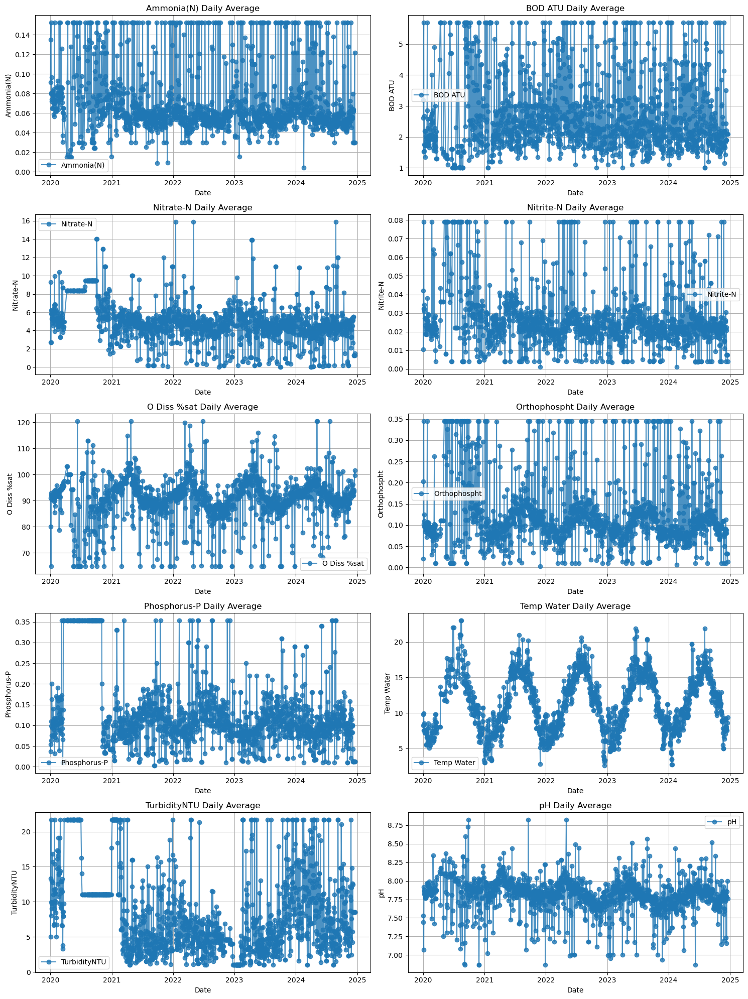

In [46]:

# Combining the 'year', 'month', and 'day' columns into a single datetime column.

df['date'] = pd.to_datetime(df[['year', 'month', 'day']])

# Sort the DataFrame by the new 'date' column to ensure correct chronological order.
df = df.sort_values('date')

# Data Aggregation:
# If a single day contains multiple measurements (from different locations), i group by the date
# and compute the average for each parameter across all measurements on that day.
daily_df = df.groupby('date')[parameters].mean().reset_index()

# Visualize the Daily Averages
# Create a grid of subplots (5 rows x 2 columns for 10 parameters)
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
axs = axs.flatten()  # Flatten the array to iterate easily over the subplots

# Loop through each parameter and plot its daily average over time.
for i, param in enumerate(parameters):
    axs[i].plot(daily_df['date'], daily_df[param], marker='o', linestyle='-', alpha=0.8, label=param)
    axs[i].set_title(f'{param} Daily Average')
    axs[i].set_xlabel('Date')
    axs[i].set_ylabel(param)
    axs[i].legend()
    axs[i].grid(True)

plt.tight_layout()
plt.show()

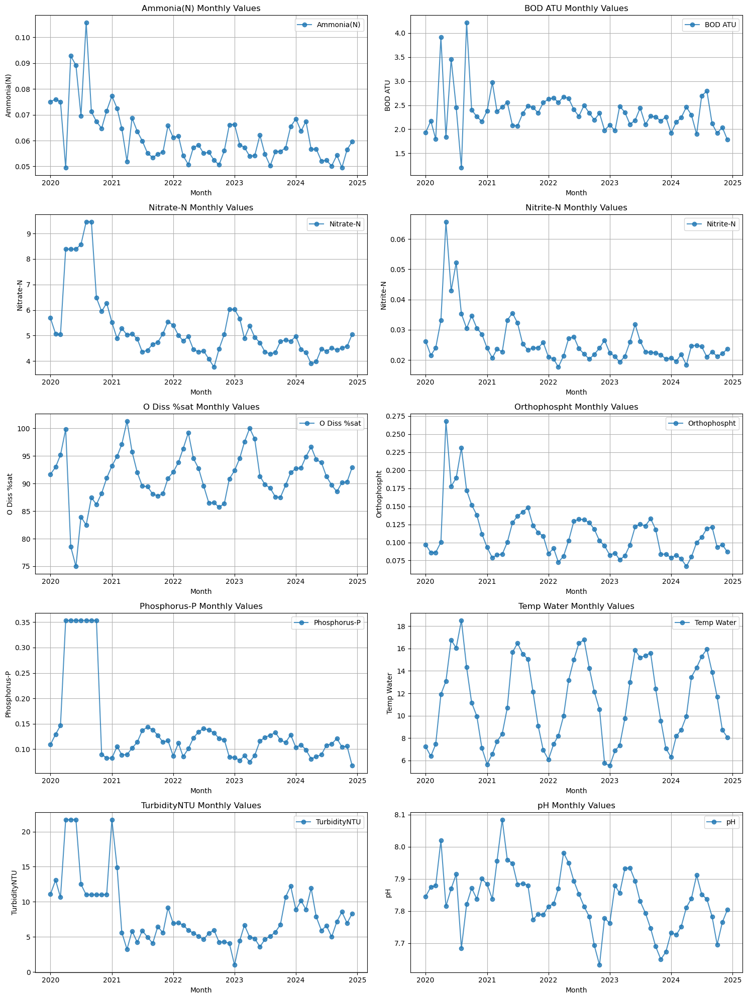

In [56]:


# Creating a new column 'month_date' that represents the first day of each month.
# This will serve as a unique identifier for each month.
df['month_date'] = pd.to_datetime(df[['year', 'month']].assign(day=1))

# Grouping the DataFrame by 'month_date' and calculate the mean for each parameter.
# This creates a new DataFrame with one row per month.
monthly_df = df.groupby('month_date')[parameters].mean().reset_index()

monthly_df.sort_values('month_date', inplace=True)

fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
axs = axs.flatten()  # Flatten the 2D array for easier iteration.

for i, param in enumerate(parameters):
    axs[i].plot(monthly_df['month_date'], monthly_df[param],
                marker='o', linestyle='-', alpha=0.8, label=param)
    axs[i].set_title(f'{param} Monthly Values')
    axs[i].set_xlabel('Month')
    axs[i].set_ylabel(param)
    axs[i].legend()
    axs[i].grid(True)

plt.tight_layout()
plt.show()

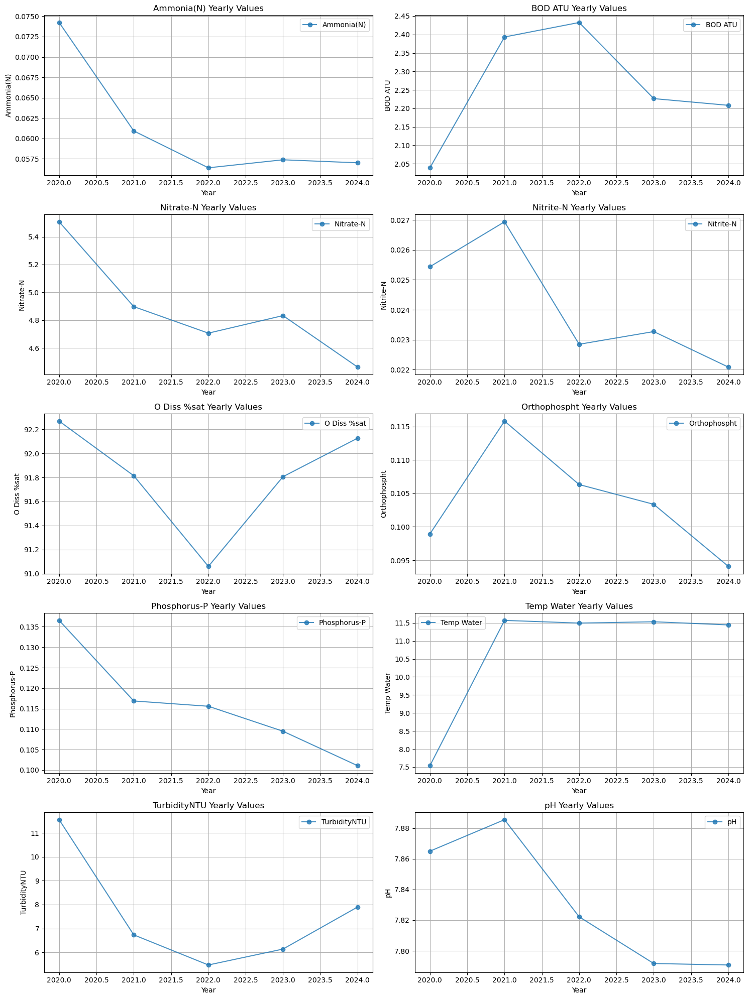

In [58]:

yearly_df = df.groupby('year')[parameters].mean().reset_index()

yearly_df.sort_values('year', inplace=True)

fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
axs = axs.flatten()  # Flatten the 2D array for easier iteration

# Loop through each parameter and plot its yearly average values.
for i, param in enumerate(parameters):
    axs[i].plot(yearly_df['year'], yearly_df[param], marker='o', linestyle='-', alpha=0.8, label=param)
    axs[i].set_title(f'{param} Yearly Values')
    axs[i].set_xlabel('Year')
    axs[i].set_ylabel(param)
    axs[i].legend()
    axs[i].grid(True)
plt.tight_layout()
plt.show()

          Ammonia(N)        BOD ATU      Nitrate-N      Nitrite-N  \
count  226219.000000  226219.000000  226219.000000  226219.000000   
mean        0.059307       2.273281       4.777385       0.023700   
std         0.046727       1.442326       4.102024       0.023796   
min         0.000000       1.000000       0.000010       0.000300   
25%         0.030000       1.200000       1.370000       0.004000   
50%         0.030000       1.700000       3.780000       0.014000   
75%         0.079000       3.000000       7.180000       0.034000   
max         0.152500       5.700000      15.895000       0.079000   

         O Diss %sat   Orthophospht   Phosphorus-P     Temp Water  \
count  226219.000000  226219.000000  226219.000000  226219.000000   
mean       91.796501       0.103065       0.112141      11.127180   
std        12.438338       0.107631       0.107340       4.195434   
min        64.850000       0.000000       0.001000       0.000000   
25%        85.700000       0.0200

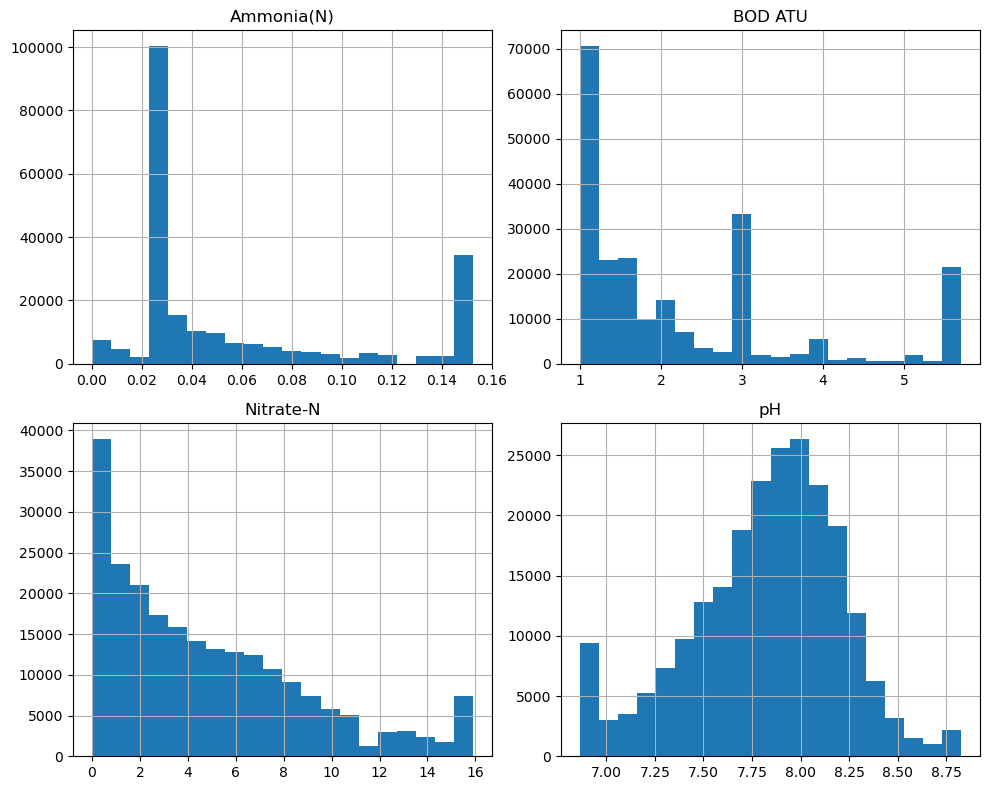

In [27]:
summary_stats = df[[
    'Ammonia(N)', 'BOD ATU', 'Nitrate-N', 'Nitrite-N',
    'O Diss %sat', 'Orthophospht', 'Phosphorus-P',
    'Temp Water', 'TurbidityNTU', 'pH'
]].describe()
print(summary_stats)

df[['Ammonia(N)', 'BOD ATU', 'Nitrate-N', 'pH']].hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()

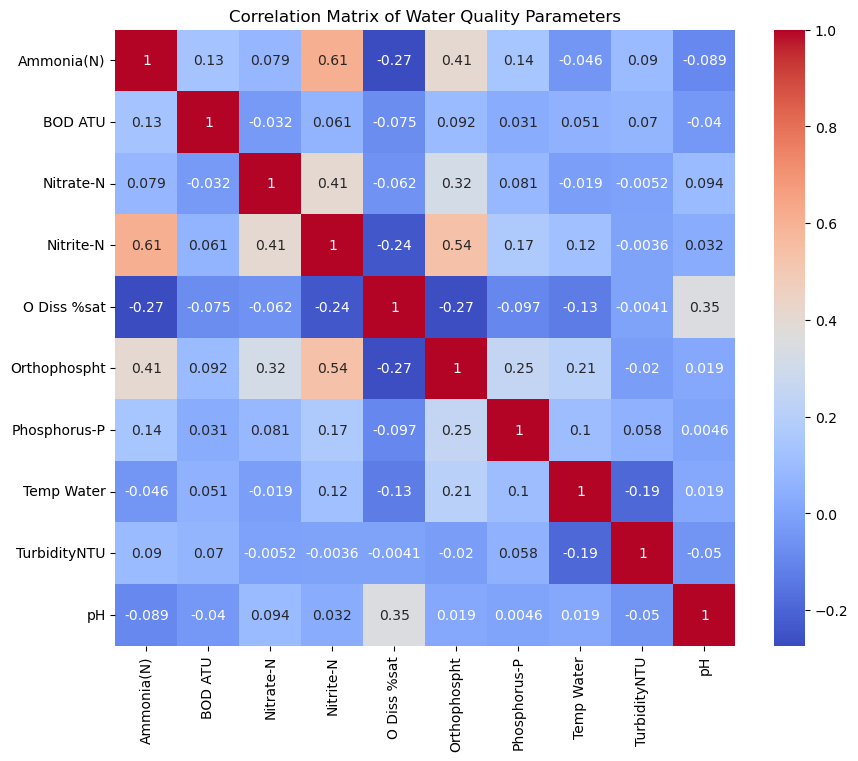

In [33]:


corr_matrix = df[[
    'Ammonia(N)', 'BOD ATU', 'Nitrate-N', 'Nitrite-N',
    'O Diss %sat', 'Orthophospht', 'Phosphorus-P',
    'Temp Water', 'TurbidityNTU', 'pH'
]].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title("Correlation Matrix of Water Quality Parameters")
plt.show()

In [26]:
# Example ideal ranges (modify these with proper values for your case)
# Adjusted ideal ranges for mixed water sources
ideal_ranges = {
    'Ammonia(N)':      {'min': 0.0,  'max': 1.0},   # mg/L (combined groundwater & surface water)
    'BOD ATU':         {'min': 0.0,  'max': 4.0},   # mg/L (higher than drinking water, but realistic for rivers/lakes)
    'Nitrate-N':       {'min': 0.0,  'max': 30.0},  # mg/L (accounts for river pollution but stays below extreme levels)
    'Nitrite-N':       {'min': 0.0,  'max': 0.3},   # mg/L (slightly above drinking water limit to allow for natural variance)
    'O Diss %sat':     {'min': 50,   'max': 120},   # % (oxygen variation in natural waters)
    'Orthophospht':    {'min': 0.0,  'max': 2.0},   # mg/L (to account for agricultural runoff in some sources)
    'Phosphorus-P':    {'min': 0.0,  'max': 0.15},  # mg/L (higher than drinking water limit but within natural ranges)
    'Temp Water':      {'min': 0.0,  'max': 30.0},  # °C (covers groundwater & river/lake seasonal changes)
    'TurbidityNTU':    {'min': 0.0,  'max': 20.0},  # NTU (since mixed sources include rivers, which are naturally higher)
    'pH':              {'min': 6.0,  'max': 9.0}    # pH scale (general range covering all sources)
}

# Example weights (summing to 1, or use relative weights)
weights = {
    'Ammonia(N)':      0.1,
    'BOD ATU':         0.1,
    'Nitrate-N':       0.1,
    'Nitrite-N':       0.1,
    'O Diss %sat':     0.15,
    'Orthophospht':    0.1,
    'Phosphorus-P':    0.1,
    'Temp Water':      0.1,
    'TurbidityNTU':    0.1,
    'pH':              0.05
}

In [28]:
import numpy as np

def calc_parameter_score(value, ideal_range, k=3):
    """
    Compute a normalized score for a parameter value given its ideal range.
    
    - If the value is within the ideal range, the score is 1.
    - If the value is below the ideal range, the relative deviation is
      computed as (min_val - value) / min_val.
    - If the value is above the ideal range, the relative deviation is
      computed as (value - max_val) / max_val.
    
    The final score is calculated as:
        score = exp(-k * deviation)
    where k is a decay constant (adjustable) that reflects the gravity of the deviation.
    
    This returns a score between 0 and 1.
    """
    min_val = ideal_range['min']
    max_val = ideal_range['max']
    
    if min_val <= value <= max_val:
        return 1.0
    else:
        if value < min_val:
            deviation = (min_val - value) / (min_val if min_val != 0 else 1)
        else:  # value > max_val
            deviation = (value - max_val) / (max_val if max_val != 0 else 1)
        
        # Exponential decay to penalize larger deviations more severely.
        score = np.exp(-k * deviation)
        return score

In [50]:
def compute_water_quality_score(row, ideal_ranges, weights, k=3):
    """
    Compute an overall water quality score for a given row.
    
    For each parameter, calculate a normalized score using calc_parameter_score,
    then combine the scores using a weighted average.
    
    Returns a score between 0 and 1.
    """
    score_sum = 0
    total_weight = 0
    
    for param, crit in ideal_ranges.items():
        value = row[param]
        param_score = calc_parameter_score(value, crit, k=k)
        weight = weights.get(param, 1)  # Default weight is 1 if not specified.
        score_sum += param_score * weight
        total_weight += weight
    
    return score_sum / total_weight if total_weight > 0 else 0

# Apply the function to each row of the DataFrame.
df['water_quality_score'] = df.apply(lambda row: compute_water_quality_score(row, ideal_ranges, weights, k=3), axis=1)

In [36]:
df.to_csv('final_water_quality_score_.csv', index=False)

In [38]:
df.head(19)


,sample.sampleDateTime,sample.samplingPoint.easting,sample.samplingPoint.northing,Ammonia(N),BOD ATU,Nitrate-N,Nitrite-N,O Diss %sat,Orthophospht,Phosphorus-P,...,Orthophospht_lag2,Phosphorus-P_lag1,Phosphorus-P_lag2,Temp Water_lag1,Temp Water_lag2,TurbidityNTU_lag1,TurbidityNTU_lag2,pH_lag1,pH_lag2,water_quality_score
0,2020-01-02 08:20:00,512248,302927,0.1525,1.7,15.895,0.0790,89.40,0.021,0.037,...,0.021,0.037,0.037,10.5,10.5,5.0,5.0,7.36,7.36,1.000000
1,2020-01-02 11:25:00,512242,302941,0.1525,2.8,15.895,0.0790,89.40,0.021,0.037,...,0.021,0.037,0.037,10.5,10.5,5.0,5.0,7.36,7.36,1.000000
2,2020-01-02 11:33:00,479766,150096,0.1525,2.8,15.895,0.0790,89.40,0.021,0.037,...,0.021,0.037,0.037,10.5,10.5,5.0,5.0,7.36,7.36,1.000000
3,2020-01-02 12:12:00,271427,47251,0.0300,2.8,2.690,0.0051,100.00,0.021,0.037,...,0.021,0.037,0.037,8.6,8.6,5.0,5.0,7.60,7.60,1.000000
4,2020-01-02 12:27:00,473010,140000,0.0300,2.8,2.690,0.0051,88.40,0.021,0.037,...,0.021,0.037,0.037,9.9,9.9,5.0,5.0,7.74,7.74,1.000000
5,2020-01-02 12:46:00,478160,137000,0.0300,2.8,2.690,0.0051,89.10,0.021,0.037,...,0.021,0.037,0.037,8.6,8.6,5.0,5.0,7.77,7.77,1.000000
6,2020-01-03 08:50:00,512245,302928,0.0300,3.0,2.690,0.0051,89.10,0.021,0.037,...,0.021,0.037,0.037,8.6,8.6,5.0,5.0,7.77,7.77,1.000000
7,2020-01-03 08:55:00,512244,302928,0.0300,1.5,2.690,0.0051,89.10,0.021,0.037,...,0.021,0.037,0.037,8.6,8.6,5.0,5.0,7.77,7.77,1.000000
8,2020-01-03 11:10:00,500000,2,0.1525,1.3,2.690,0.0051,89.00,0.210,0.037,...,0.210,0.037,0.037,8.0,8.0,5.0,5.0,7.77,7.77,1.000000
9,2020-01-03 11:15:00,604515,222393,0.1525,1.3,2.690,0.0051,84.20,0.210,0.037,...,0.210,0.037,0.037,8.5,8.5,5.0,5.0,7.28,7.28,1.000000


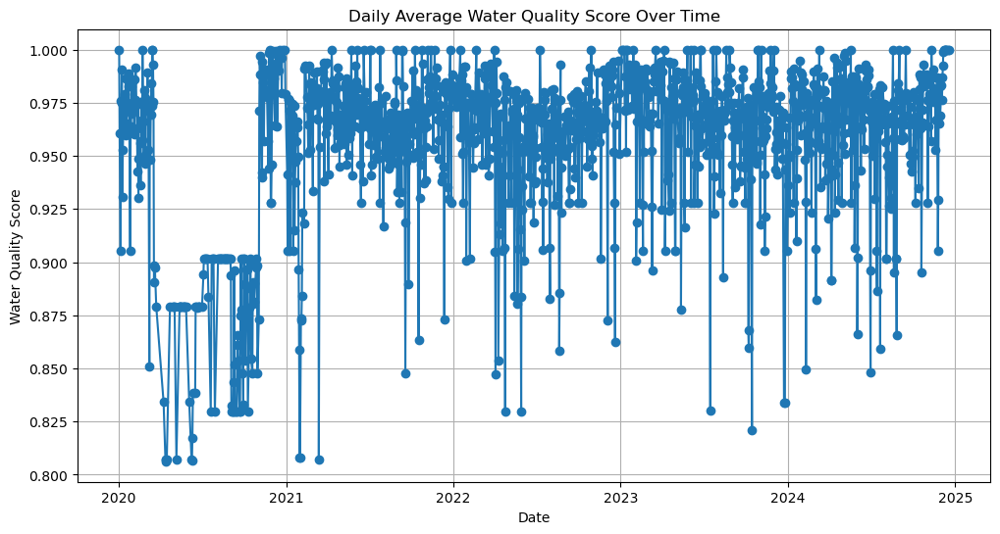

In [51]:
# Group by the 'date' column and compute the mean water quality score
daily_avg = df.groupby('date')['water_quality_score'].mean().reset_index()

# Plot the daily average water quality score over time
plt.figure(figsize=(12, 6))
plt.plot(daily_avg['date'], daily_avg['water_quality_score'], marker='o', linestyle='-')
plt.title("Daily Average Water Quality Score Over Time")
plt.xlabel("Date")
plt.ylabel("Water Quality Score")
plt.grid(True)
plt.show()

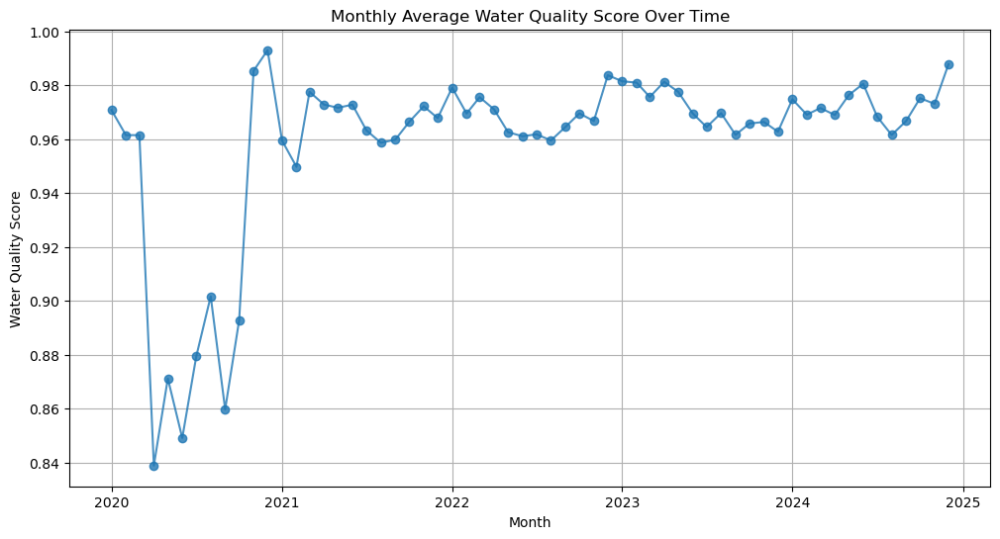

In [60]:


# Group the DataFrame by 'month_date' and calculate the mean water quality score.
monthly_avg_score = df.groupby('month_date')['water_quality_score'].mean().reset_index()

# Sort the monthly DataFrame by 'month_date' to ensure chronological order.
monthly_avg_score.sort_values('month_date', inplace=True)

# Plot the monthly average water quality score over time.
plt.figure(figsize=(12, 6))
plt.plot(monthly_avg_score['month_date'], monthly_avg_score['water_quality_score'], 
         marker='o', linestyle='-', alpha=0.8)
plt.title("Monthly Average Water Quality Score Over Time")
plt.xlabel("Month")
plt.ylabel("Water Quality Score")
plt.grid(True)
plt.show()

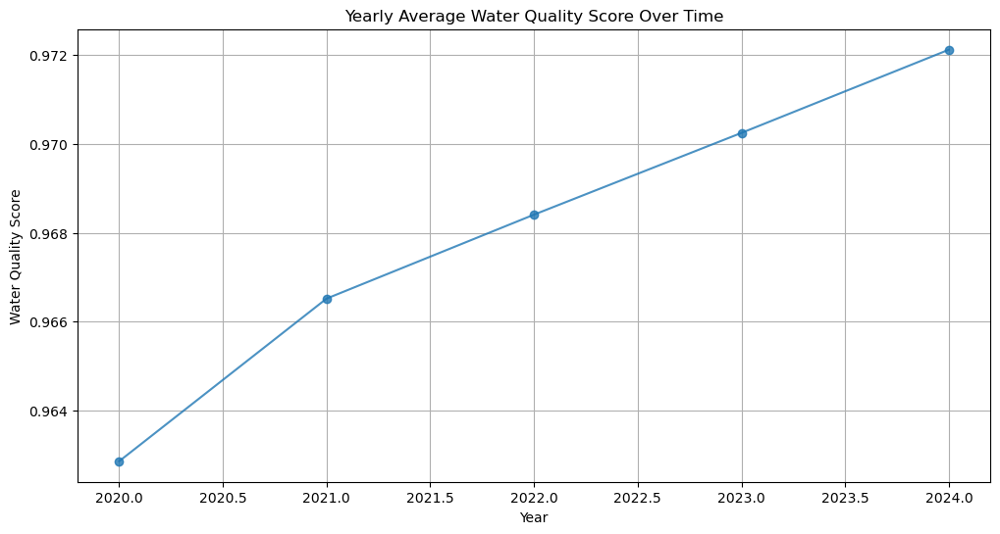

In [62]:
# Group the DataFrame by 'year' and calculate the mean water quality score for each year.
yearly_avg_score = df.groupby('year')['water_quality_score'].mean().reset_index()

# Sort the aggregated DataFrame by 'year' to ensure chronological order.
yearly_avg_score.sort_values('year', inplace=True)

# Plot the yearly average water quality score over time.
plt.figure(figsize=(12, 6))
plt.plot(yearly_avg_score['year'], yearly_avg_score['water_quality_score'], 
         marker='o', linestyle='-', alpha=0.8)
plt.title("Yearly Average Water Quality Score Over Time")
plt.xlabel("Year")
plt.ylabel("Water Quality Score")
plt.grid(True)
plt.show()

In [64]:
# Group the DataFrame by location (Easting and Northing) and compute the mean water quality score.
location_summary = df.groupby(['sample.samplingPoint.easting', 'sample.samplingPoint.northing'])['water_quality_score'].mean().reset_index()

# Now location_summary contains one row per unique location with the average water quality score.
print(location_summary.head())

   sample.samplingPoint.easting  sample.samplingPoint.northing  \
0                        135954                          32379   
1                        137309                          31822   
2                        137749                          31908   
3                        138074                          25951   
4                        138430                          23930   

   water_quality_score  
0             0.970248  
1             0.982467  
2             0.953298  
3             1.000000  
4             0.971338  


In [66]:
import pandas as pd
import folium
from pyproj import Transformer
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# --- Step 1: Aggregating the water quality score by location ---
# Group by unique locations (using Easting and Northing) and average the water_quality_score.
location_summary = df.groupby(['sample.samplingPoint.easting', 'sample.samplingPoint.northing'])['water_quality_score'].mean().reset_index()

# --- Step 2: Convert Easting/Northing to Latitude/Longitude ---

transformer = Transformer.from_crs("EPSG:27700", "EPSG:4326", always_xy=True)

def convert_coords(easting, northing):
    # transformer.transform returns (longitude, latitude)
    lon, lat = transformer.transform(easting, northing)
    return lat, lon

# Apply the conversion function to each row of location_summary.
location_summary['lat'], location_summary['lon'] = zip(*location_summary.apply(
    lambda row: convert_coords(row['sample.samplingPoint.easting'], row['sample.samplingPoint.northing']),
    axis=1
))

# --- Step 3: Create a Color Mapping for the Water Quality Score ---
colormap = plt.get_cmap('RdYlGn') 

def score_to_hex(score):
    """
    Converts a water quality score (0 to 1) to a hex color.
    """
    # The colormap expects a value in the range [0, 1]. A score of 0 will be red, 1 will be green.
    rgba = colormap(score)  # returns an (R,G,B,A) tuple
    return mcolors.rgb2hex(rgba)

# --- Step 4: Create a Folium Map ---
# Center the map on the average location from the aggregated data.
avg_lat = location_summary['lat'].mean()
avg_lon = location_summary['lon'].mean()
m = folium.Map(location=[avg_lat, avg_lon], zoom_start=10)

# --- Step 5: Add Circle Markers for Each Location ---
# Each marker's color reflects the water quality score.
for idx, row in location_summary.iterrows():
    color = score_to_hex(row['water_quality_score'])
    folium.CircleMarker(
        location=[row['lat'], row['lon']],
        radius=5,
        popup=f"Score: {row['water_quality_score']:.2f}",
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7
    ).add_to(m) 

# --- Step 6: Display the Map ---
# Save the map to an HTML file and display it.
m.save('water_quality_map.html')
m